In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import cv2
import random
import time
import unittest
from IPython import display
import tensorflow as tf
from keras.initializers import RandomNormal
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import (
    Reshape,
    Dense,
    Conv2D,
    Conv2DTranspose,
    Flatten,
    BatchNormalization,
    MaxPooling2D,
    Reshape,
    Input,
    Dropout,
)
from keras.layers.advanced_activations import ReLU, LeakyReLU
from keras.layers import Input
from keras.models import Model

In [3]:
img_size = 64
noise_dim = 100


batch_size = 64
steps_per_epoch = 3000
epochs = 10000


DIR = r"C:\Users\Desktop\Desktop\JuPyter Notebooks\GANs\PokemonDataset\pokemon_jpg\pokemon_jpg"
save_path = r"C:\Users\Desktop\Desktop\JuPyter Notebooks\GANs\SimpleGANs\DCGANS_Pokemon"

optimizer = tf.keras.optimizers.Adam(0.0002, 0.5)

In [4]:
def load_data(data_path):

    image_list = []
    file_list = os.listdir(data_path)
    for image in file_list:
        path = os.path.join(data_path, image)
        image_single = cv2.imread(path)
        image_single = cv2.resize(image_single, (img_size, img_size))
        image_list.append(image_single)
    # print(len(image_list))
    # plt.imshow(cv2.cvtColor(image_single, cv2.COLOR_BGR2RGB))
    return image_list

In [5]:
images = load_data(DIR)

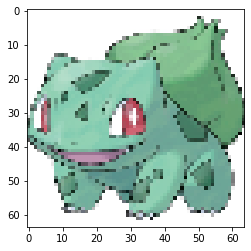

In [6]:
def visualize_images(images):
    for image in images:
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        break


visualize_images(images)

In [7]:
def create_train_data(images):
    x_train = np.array(images)
    x_train = x_train.astype("float32")
    x_train /= 127.5
    x_train -= 1
    img_rows, img_cols, channels = x_train[1].shape
    return x_train, img_rows, img_cols, channels

In [8]:
x_train, img_rows, img_cols, channels = create_train_data(images)

In [8]:
def generator_model():
    n = 8
    # noise_input = Input([1, noise_dim])
    gen_model = Sequential()
    gen_model.add(Dense(n * n * 256, use_bias=False, input_shape=(noise_dim,)))
    gen_model.add(Reshape((n, n, 256)))
    gen_model.add(BatchNormalization())
    gen_model.add(LeakyReLU())

    gen_model.add(
        Conv2DTranspose(128, (5, 5), strides=(2, 2), padding="same", use_bias=False)
    )
    gen_model.add(BatchNormalization())
    gen_model.add(LeakyReLU())

    gen_model.add(
        Conv2DTranspose(64, (5, 5), strides=(2, 2), padding="same", use_bias=False)
    )
    gen_model.add(BatchNormalization())
    gen_model.add(LeakyReLU())
    gen_model.add(
        Conv2DTranspose(
            channels,
            (5, 5),
            strides=(2, 2),
            padding="same",
            use_bias=False,
            activation="tanh",
        )
    )

    return gen_model

In [9]:
def discriminator_model():
    # image_input = Input((img_rows, img_cols, channels))
    disc_model = Sequential()
    disc_model.add(
        Conv2D(64, (5, 5), padding="same", input_shape=(img_rows, img_cols, channels))
    )
    disc_model.add(LeakyReLU())
    disc_model.add(Dropout(0.3))

    disc_model.add(Conv2D(128, (5, 5), strides=(2, 2), padding="same"))
    disc_model.add(Flatten())
    disc_model.add(Dense(1, activation="sigmoid"))

    return disc_model

In [10]:
generator = generator_model()

In [11]:
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 16384)             1638400   
_________________________________________________________________
reshape (Reshape)            (None, 8, 8, 256)         0         
_________________________________________________________________
batch_normalization (BatchNo (None, 8, 8, 256)         1024      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 16, 16, 128)       819200    
_________________________________________________________________
batch_normalization_1 (Batch (None, 16, 16, 128)       512       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 16, 16, 128)       0

In [12]:
discriminator = discriminator_model()

In [13]:
discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 64, 64, 64)        4864      
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 64, 64, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 128)       204928    
_________________________________________________________________
flatten (Flatten)            (None, 131072)            0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 131073    
Total params: 340,865
Trainable params: 340,865
Non-trainable params: 0
________________________________________________

In [21]:
class UnitTest(unittest.TestCase):
    def test_train_data(self):
        images_expected = []
        for i in range(2):
            image_expected = np.random.randint(0, 255, (64, 64, 3))
            images_expected.append(image_expected)
        x_expected = np.array(images_expected)
        (
            expected_examples,
            expected_rows,
            expected_cols,
            expected_channels,
        ) = x_expected.shape
        expected_result = [
            expected_examples,
            expected_rows,
            expected_cols,
            expected_channels,
        ]

        result = create_train_data(images_expected)
        true_examples, true_rows, true_cols, true_channels = result
        true_result = [true_examples, true_rows, true_cols, true_channels]

        self.assertEqual(x_expected.ndim, result[0].ndim)
        self.assertEqual(expected_result[1:4], true_result[1:4])
        self.assertGreaterEqual(1, np.max(true_result[0]))
        self.assertLessEqual(-1, np.min(true_result[0]))


if __name__ == "__main__":
    unittest.main(argv=["first-arg-is-ignored"], exit=False)

.
----------------------------------------------------------------------
Ran 1 test in 0.001s

OK


In [14]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)


def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss


def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [15]:
@tf.function
def train_step(images):
    noise = tf.random.normal([batch_size, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        gradients_of_generator = gen_tape.gradient(
            gen_loss, generator.trainable_variables
        )
        gradients_of_discriminator = disc_tape.gradient(
            disc_loss, discriminator.trainable_variables
        )

        optimizer.apply_gradients(
            zip(gradients_of_generator, generator.trainable_variables)
        )
        optimizer.apply_gradients(
            zip(gradients_of_discriminator, discriminator.trainable_variables)
        )

In [16]:
num_examples_to_generate = 16

seed = np.random.normal(0, 1, size=(num_examples_to_generate, noise_dim))


def train(dataset, epochs, save_after):

    generate_and_save_images(generator, 0, seed)

    for epoch in range(epochs):
        for image_batch in dataset:
            image_batch = tf.expand_dims(image_batch, axis=0)
            train_step(image_batch)

        if (epoch + 1) % save_after == 0:
            # images for the GIF
            display.clear_output(wait=True)
            generate_and_save_images(generator, epoch + 1, seed)

    # Generate after the final epoch
    display.clear_output(wait=True)
    generate_and_save_images(generator, epochs, seed)

In [17]:
def generate_and_save_images(model, epoch, test_input):
    # Notice `training` is set to False.
    # This is so all layers run in inference mode (batchnorm).
    predictions = model(test_input, training=False)

    fig = plt.figure(figsize=(10, 10))

    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i + 1)
        if predictions.shape[-1] == 3:
            plt.imshow(
                predictions[i] * 0.5 + 0.5
            )  # scale image to [0, 1] floats (or you could also scale to [0, 255] ints)
        else:
            plt.imshow(
                predictions[i, :, :, 0] * 0.5 + 0.5, cmap="gray"
            )  # scale image to [0, 1] floats (or you could also scale to [0, 255] ints)
        plt.axis("off")
    plt.suptitle(f"Epoch {epoch}")
    plt.savefig("image_at_epoch_{:04d}.png".format(epoch))
    plt.show()

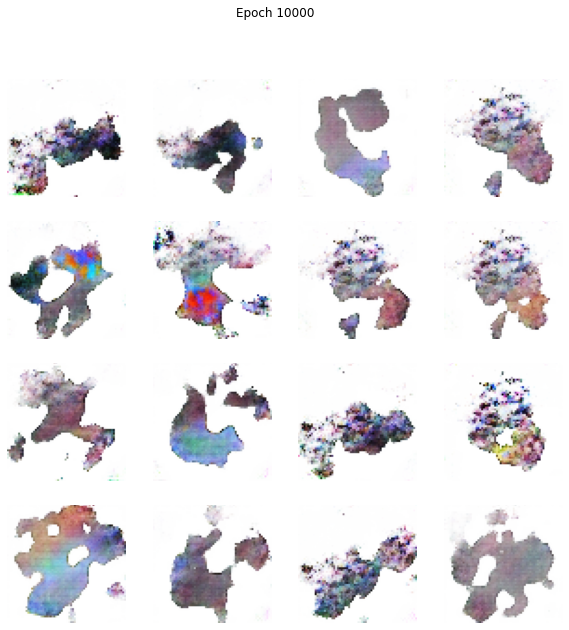

In [18]:
train(x_train, epochs, save_after=100)

### Save model and weights

In [20]:
discriminator.save(
    r"C:\Users\Desktop\Desktop\JuPyter Notebooks\GANs\trained_checkpoint\disc_model"
)

INFO:tensorflow:Assets written to: C:\Users\Desktop\Desktop\JuPyter Notebooks\GANs\trained_checkpoint\disc_model\assets


In [21]:
generator.save(
    r"C:\Users\Desktop\Desktop\JuPyter Notebooks\GANs\trained_checkpoint\gen_model"
)

INFO:tensorflow:Assets written to: C:\Users\Desktop\Desktop\JuPyter Notebooks\GANs\trained_checkpoint\gen_model\assets


### Visualize generated images 

In [25]:
import imageio
import glob

In [26]:
gif_file = "dcgan.gif"

with imageio.get_writer(gif_file, mode="I") as writer:
    filenames = glob.glob("image*.png")
    filenames = sorted(filenames)
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)


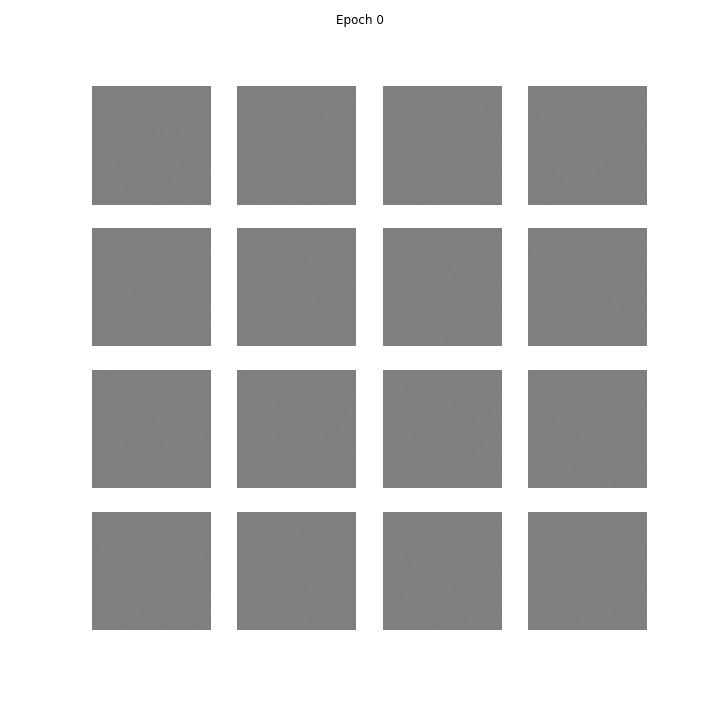

In [28]:
import tensorflow_docs.vis.embed as embed

embed.embed_file(gif_file)